<a href="https://colab.research.google.com/github/ViniciusKanh/ObjectPersonDetection-YOLOv5/blob/main/ProjetoPDI_RecObjYOLOV5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

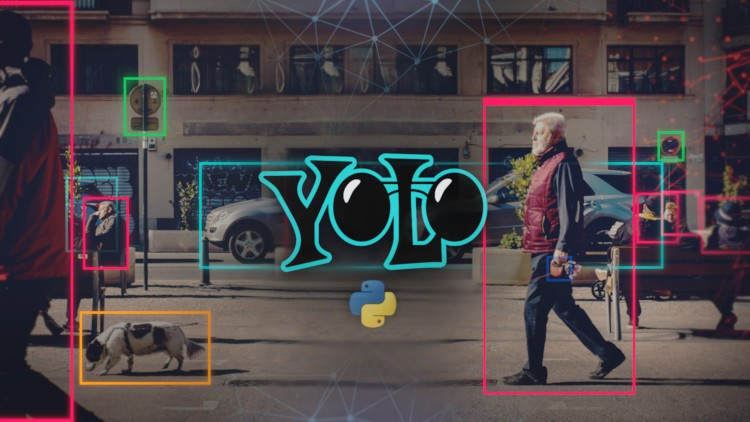

# Aplicação e Análise do YOLOv5 para Detecção de Objetos em Imagens: Uma Abordagem em Tempo Real com Processamento Digital

## 🚀 Viabilidade

Este projeto visa explorar a viabilidade da aplicação de técnicas de detecção de objetos usando o modelo YOLOv5 em imagens e vídeos para identificação e rastreamento de objetos em tempo real. A detecção de objetos é uma área crucial em visão computacional e pode ser aplicada em diversos campos, como segurança, veículos autônomos, vigilância por vídeo e muito mais.

## 🌟 Introdução

A detecção de objetos é um dos principais desafios em visão computacional. O YOLOv3 (You Only Look Once) é um dos modelos de referência para essa tarefa. Este projeto visa implementar e avaliar o desempenho do YOLOv5 na detecção de objetos em tempo real, com foco na precisão e na velocidade de processamento.

## 📚 Estudos Relacionados

Alguns estudos relacionados a esta pesquisa incluem:

- Trabalhos anteriores sobre detecção de objetos usando YOLO.
- Pesquisas sobre redes neurais convolucionais aplicadas à visão computacional.
- Avaliação de métricas de desempenho para detecção de objetos.

## 📊 Metodologia

### 1. Coleta de Dados

- Obtenção de conjuntos de dados contendo imagens e anotações de objetos.
- Pré-processamento e organização dos dados.

### 2. Implementação do Modelo YOLOv5

- Configuração e treinamento do modelo YOLOv5 usando um ambiente como Darknet.
- Ajustes de hiperparâmetros para otimizar o desempenho.

### 3. Avaliação de Desempenho

- Medição da precisão e da velocidade de detecção em diferentes conjuntos de dados.
- Comparação com outros modelos de detecção de objetos.

### 4. Aplicação em Tempo Real

- Implementação de um sistema de detecção de objetos em tempo real.
- Testes de desempenho em vídeos em tempo real.

## 📌 Conclusão

Este projeto de pesquisa visa contribuir para o campo da visão computacional, avaliando a viabilidade e o desempenho da detecção de objetos com o modelo YOLOv3. Espera-se que os resultados obtenham aplicações práticas em várias áreas.



Conexão com o Google Driver

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Clonar o repositório YOLOv5
!git clone https://github.com/ultralytics/yolov5.git yolov5

# Entrar na pasta do repositório
%cd yolov5

# Instalar as dependências
!pip install -U -r requirements.txt


## Instalando as bibliotecas necessárias

In [ ]:
!pip install -U -q numpy opencv-python pillow PyYAML
!pip install -U -q torch torchvision

# Bibliotecas necessarias

In [ ]:
import torch
from PIL import Image
from pathlib import Path
from IPython.display import display
from google.colab import files  # Importe a biblioteca para fazer o upload
import io

## Inicializar o modelo YOLOv5

In [ ]:
model = torch.hub.load("ultralytics/yolov5", "yolov5s")

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 v7.0-228-g4d687c8 Python-3.10.12 torch-2.1.0+cu118 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


## **Uploada de uma imagem**

Saving No Bras.jpg to No Bras (2).jpg


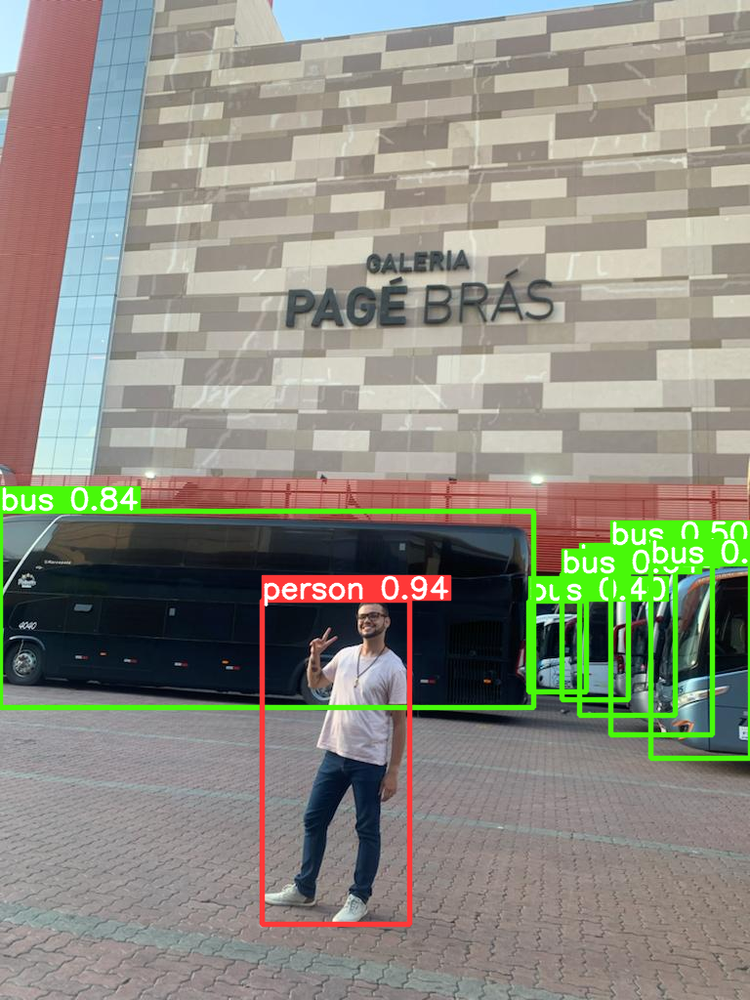

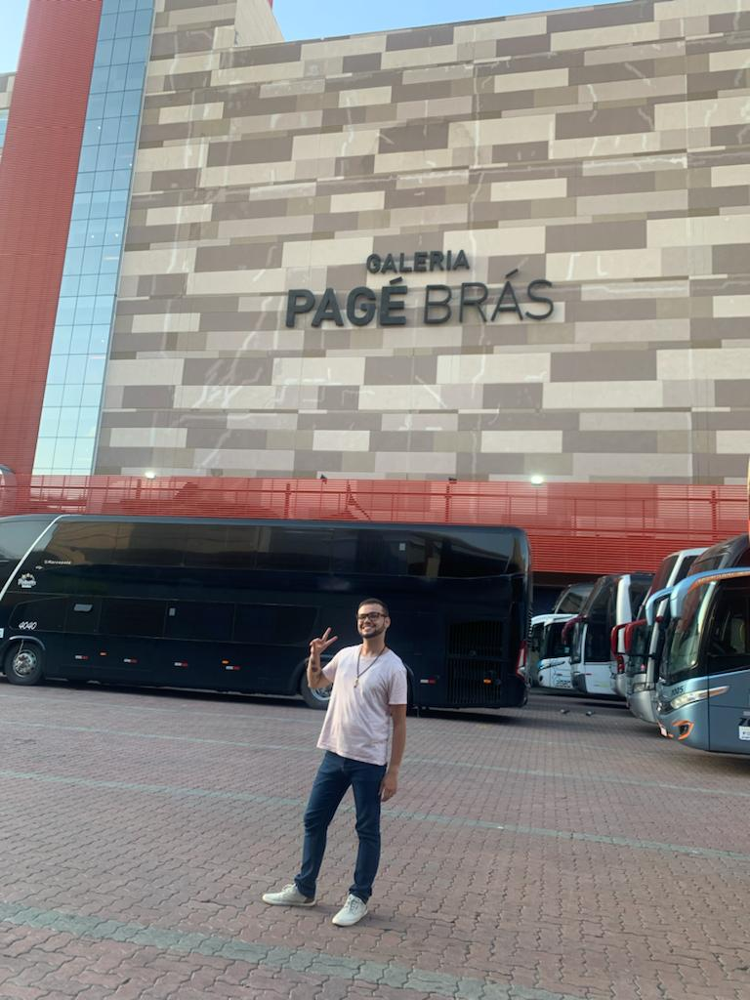

In [ ]:
# Fazer upload da imagem
uploaded = files.upload()  # O usuário fará o upload da imagem aqui

# Extrair o nome do arquivo da imagem
image_filename = next(iter(uploaded))

# Carregar a imagem
img = Image.open(io.BytesIO(uploaded[image_filename]))  # Correção: importe a biblioteca io

# Realizar a detecção
results = model(img)

# Exibir resultados
results.show()

# Exibir a imagem com caixas delimitadoras
display(img)

# Deteção em massa por ZIP

Primeiro, faça o upload do arquivo ZIP contendo as imagens:

In [ ]:
from google.colab import files

# Fazer upload do arquivo ZIP
uploaded_zip = files.upload()


Saving Images.zip to Images.zip


Extraia o conteúdo do arquivo ZIP e crie uma pasta para armazenar as imagens:


In [ ]:
import zipfile
import os

# Nome do arquivo ZIP
zip_filename = next(iter(uploaded_zip))

# Pasta de destino para as imagens
output_folder = "imagens_para_detecao"
os.makedirs(output_folder, exist_ok=True)

# Extrair as imagens do arquivo ZIP
with zipfile.ZipFile(io.BytesIO(uploaded_zip[zip_filename]), 'r') as zip_ref:
    zip_ref.extractall(output_folder)


Carregue o modelo YOLOv5 e realize a detecção nas imagens:


Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 v7.0-228-g4d687c8 Python-3.10.12 torch-2.1.0+cu118 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


Saving Images.zip to Images (6).zip


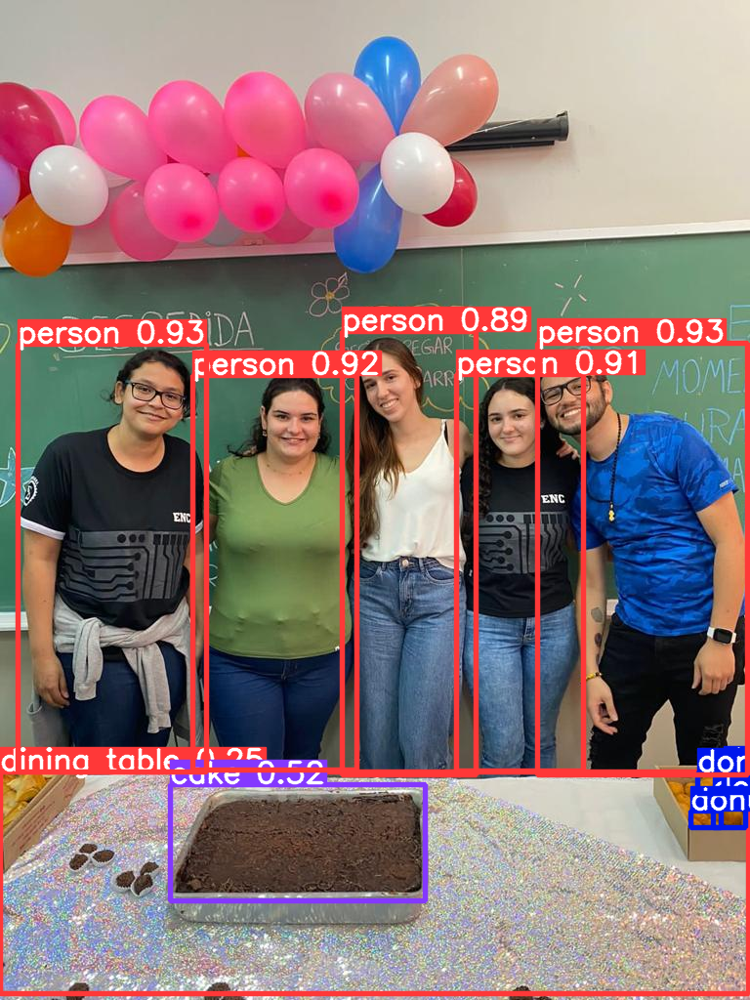

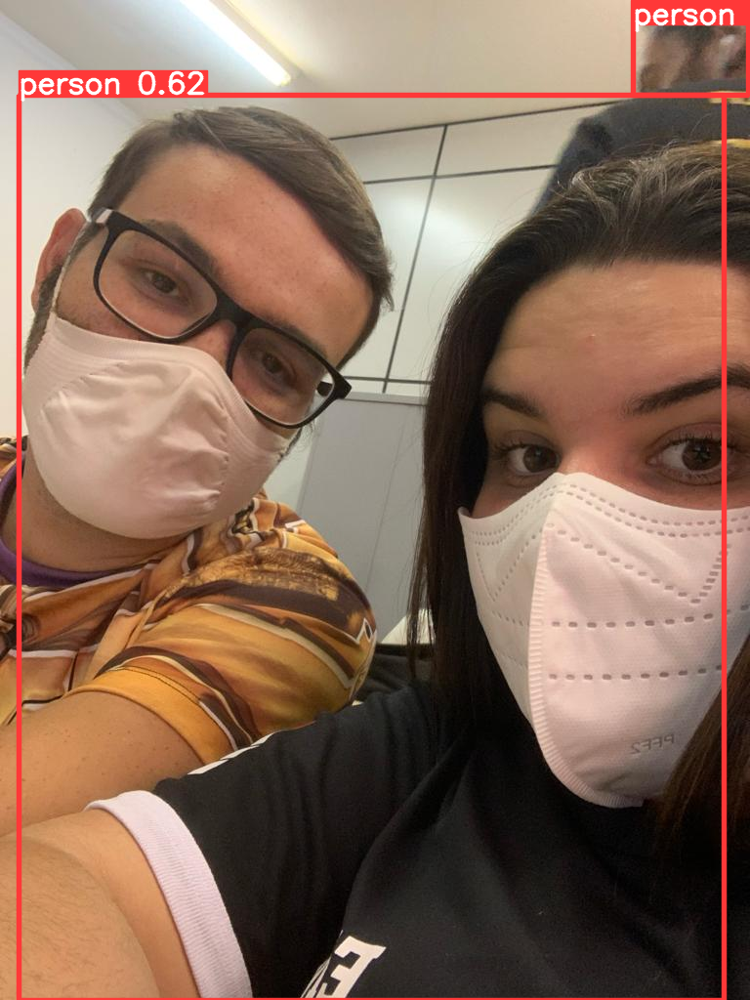

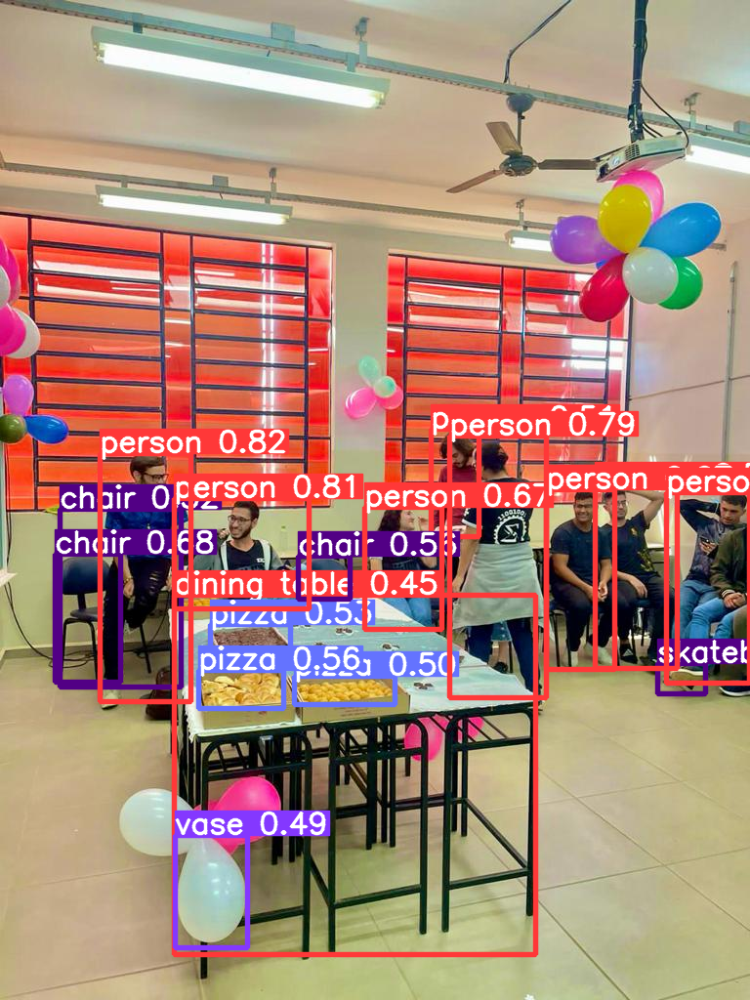

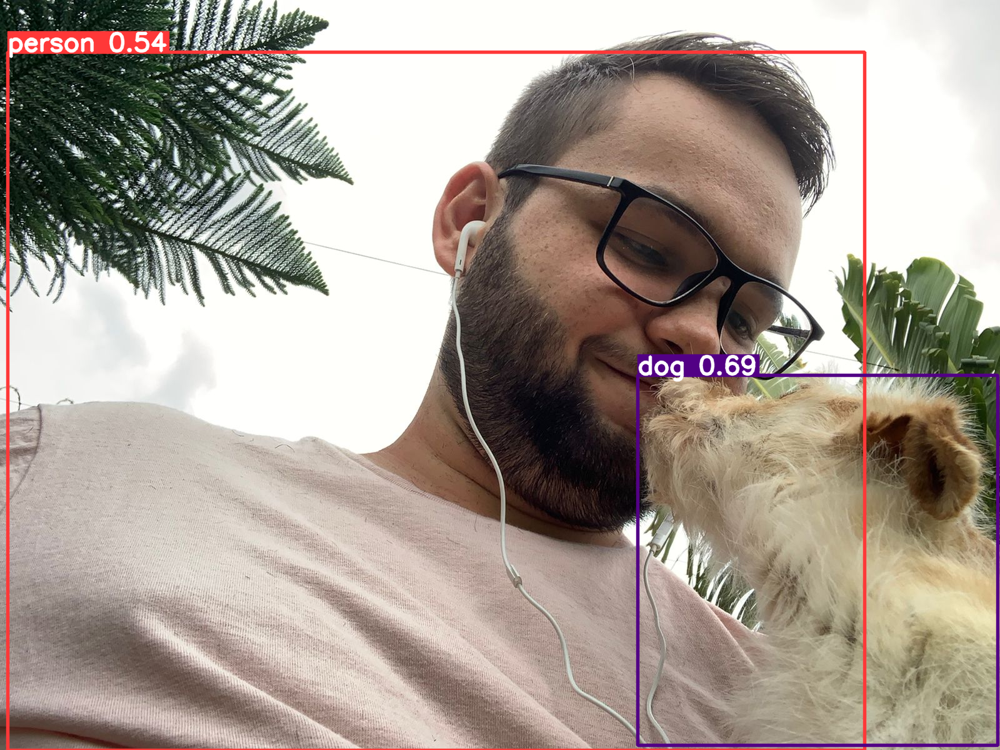

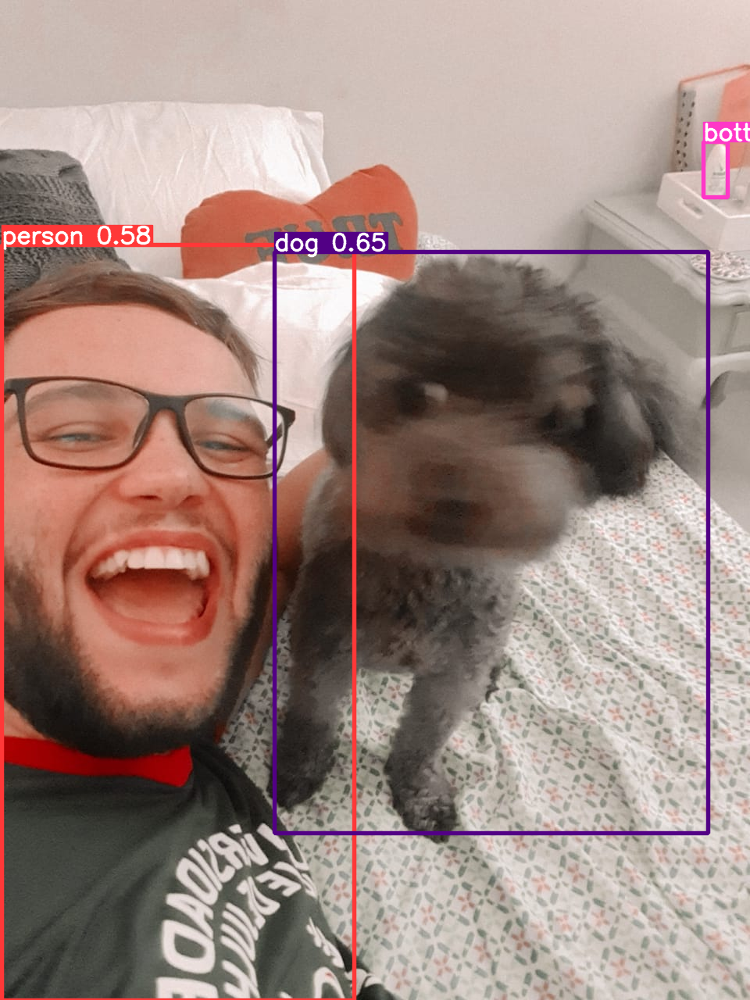

...

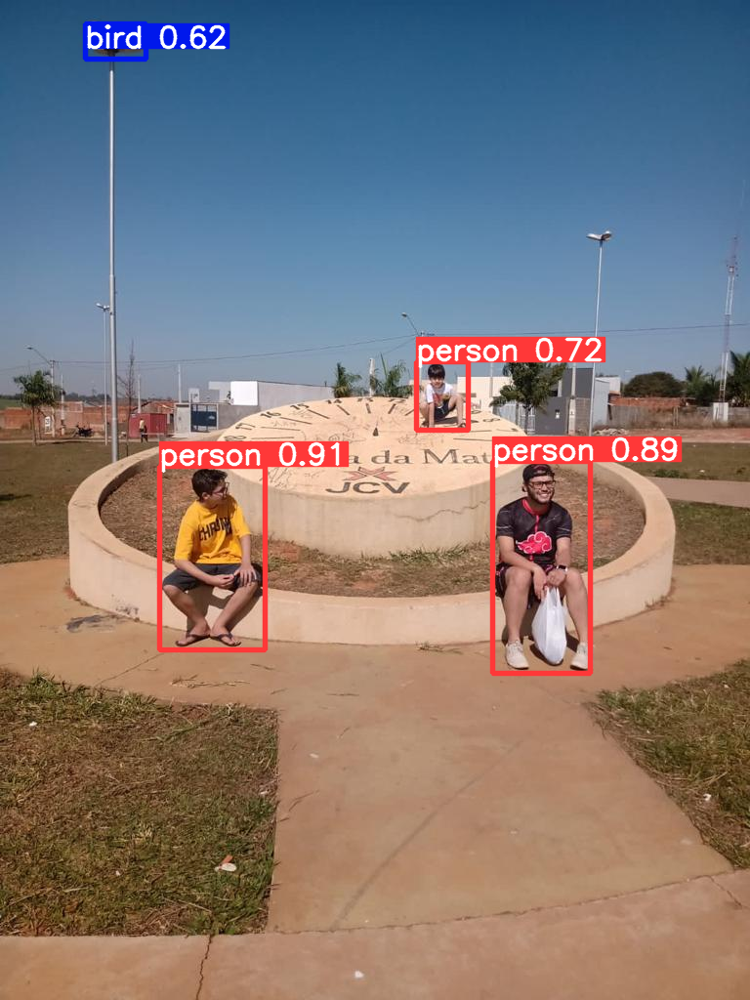

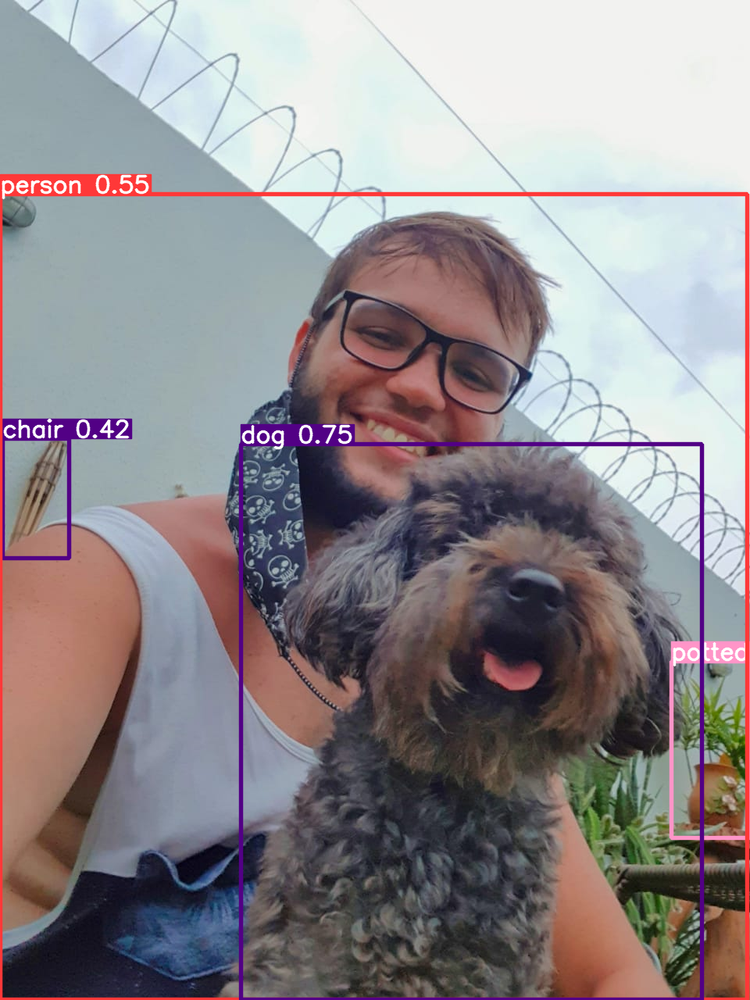

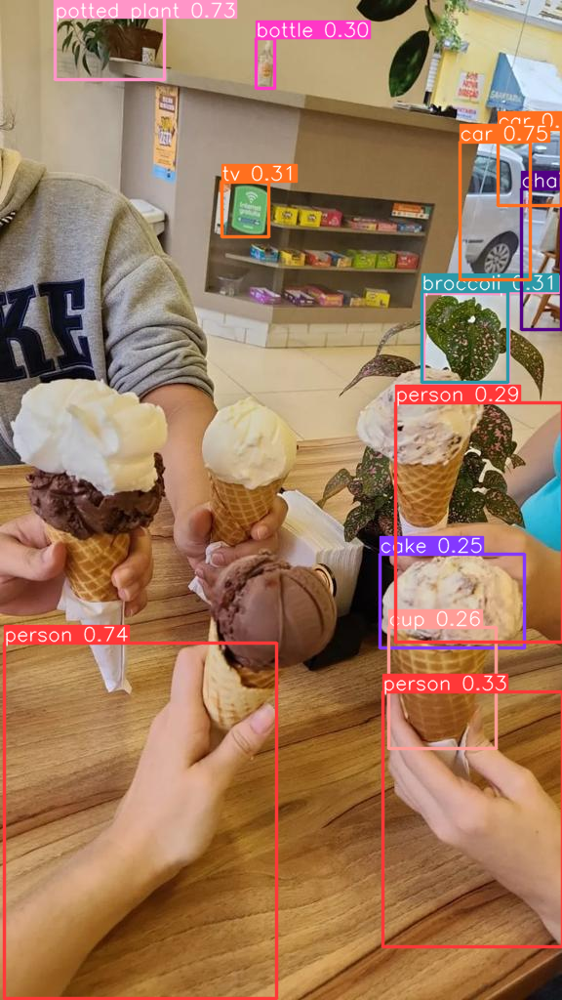

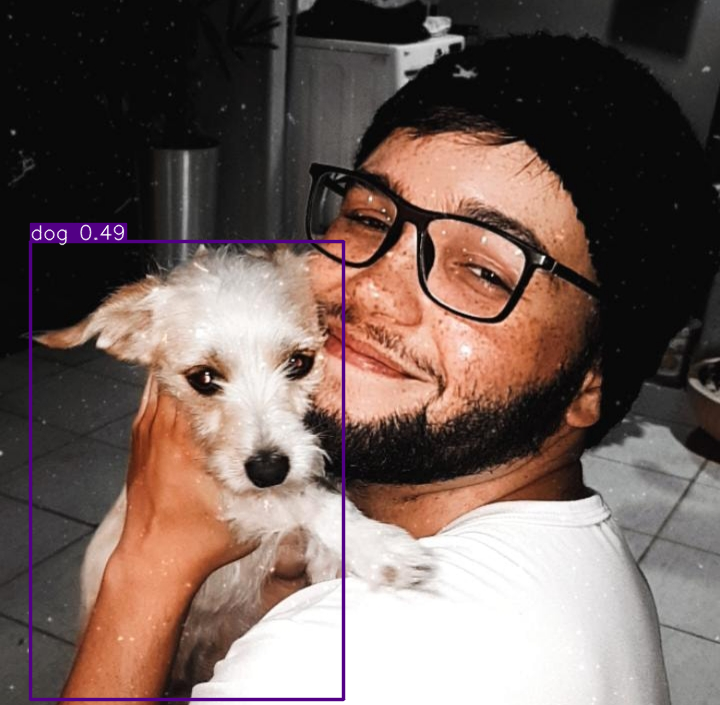

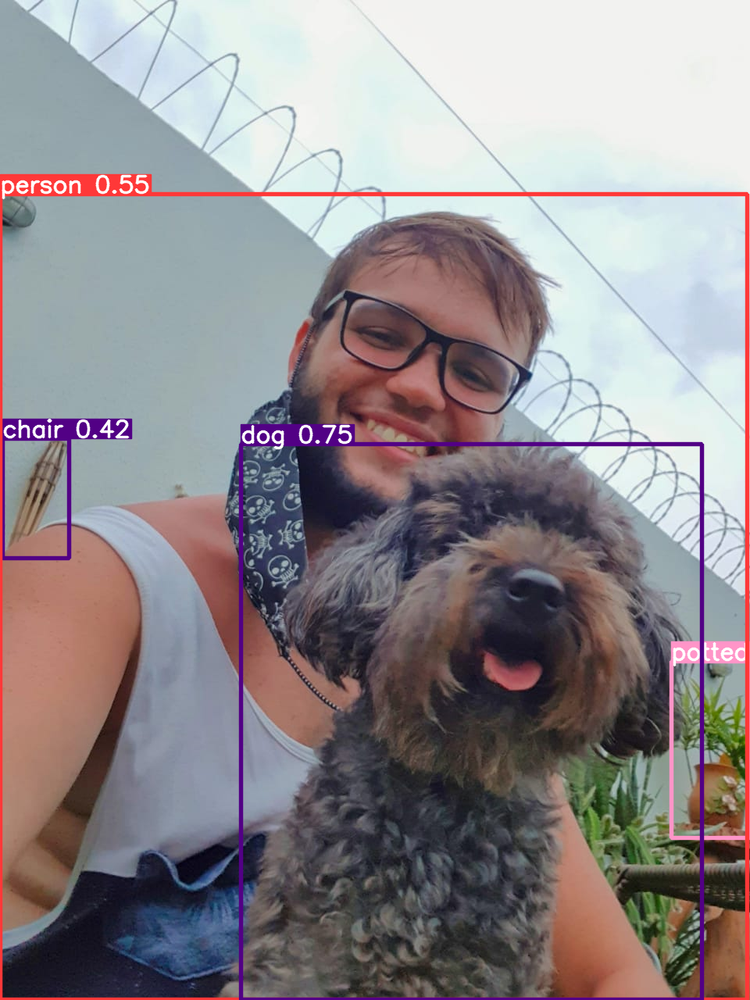

In [36]:
import torch
from PIL import Image
import zipfile
from io import BytesIO
import IPython.display as display
from pathlib import Path
from google.colab import files
import cv2
import numpy as np

# Carregar o modelo YOLOv5
model = torch.hub.load("ultralytics/yolov5", "yolov5s")

# Fazer o upload do arquivo ZIP
uploaded = files.upload()

# Extrair as imagens do arquivo ZIP e realizar a detecção
for zip_filename, zip_content in uploaded.items():
    with zipfile.ZipFile(BytesIO(zip_content), "r") as zip_file:
        image_files = [info for info in zip_file.infolist() if not info.is_dir()]

        for image_info in image_files:
            with zip_file.open(image_info) as image_file:
                # Carregar a imagem
                img = Image.open(image_file)

                # Realizar a detecção com YOLOv5
                results = model(img)

                # Converter a matriz de pixel em objeto de imagem
                img_detected = Image.fromarray(results.render()[0])

                # Exibir a imagem com caixas delimitadoras
                display.display(img_detected)


# Relatorio de Detecção

In [ ]:
!pip install reportlab
!pip install PyMuPDF

In [61]:
import os
import zipfile
from io import BytesIO
from pathlib import Path
from PIL import Image
from reportlab.lib.pagesizes import letter
from reportlab.lib import colors
from reportlab.platypus import SimpleDocTemplate, Paragraph, Image as RLImage, Table, TableStyle
from reportlab.lib.styles import getSampleStyleSheet
from IPython.display import display

# Crie o diretório de saída se ele não existir
output_dir = '/content/drive/My Drive/Faculdade/Aula/2023.2/Processamento Digital de Imagem/Projeto_Reconhecimento_Objetos/FaceMaskDetection_Yolov5'
os.makedirs(output_dir, exist_ok=True)

# Caminho para o arquivo PDF de relatório
report_pdf_path = os.path.join(output_dir, 'relatorio.pdf')

# Crie um objeto PDF
doc = SimpleDocTemplate(report_pdf_path, pagesize=letter)

# Lista para armazenar o conteúdo do PDF
elements = []

# Estilos para o texto
styles = getSampleStyleSheet()
style_normal = styles['Normal']
style_heading = styles['Heading1']

# Extrair as imagens do arquivo ZIP e realizar a detecção
for zip_filename, zip_content in uploaded.items():
    with zipfile.ZipFile(BytesIO(zip_content), "r") as zip_file:
        image_files = [info for info in zip_file.infolist() if not info.is_dir()]

        for image_info in image_files:
            with zip_file.open(image_info) as image_file:
                # Carregar a imagem
                img = Image.open(image_file)

                # Realizar a detecção com YOLOv5
                results = model(img)

                # Salvar a imagem com as detecções no diretório desejado
                detected_image_path = os.path.join(output_dir, f"detected_{os.path.basename(image_info.filename)}")
                img_detected = Image.fromarray(results.render()[0])
                img_detected.save(detected_image_path)

                # Adicionar imagem ao PDF
                elements.append(RLImage(detected_image_path, width=300, height=300))

                # Adicionar título da imagem
                image_title = Paragraph(f'Imagem: {os.path.basename(image_info.filename)}', style_heading)
                elements.append(image_title)

                # Crie uma tabela para exibir as detecções
                data = [['Objeto', 'Confiança', 'Coordenadas']]

                # Lista de classes do modelo YOLOv5
                classes = model.names

                # Linhas da tabela com informações de detecção
                for detection in results.xyxy[0]:
                    object_code = int(detection[5])  # Obtenha o código do objeto
                    object_name = classes[object_code]  # Obtenha o nome do objeto diretamente

                    confidence = f"{detection[4]:.2f}"
                    coordinates = [f"{coord:.2f}" for coord in detection[:4]]

                    # Adicione as informações à tabela
                    data.append([object_name, confidence, ', '.join(coordinates)])

                # Crie uma tabela no PDF
                table = Table(data)
                table.setStyle(TableStyle([('BACKGROUND', (0, 0), (-1, 0), colors.grey),
                                          ('TEXTCOLOR', (0, 0), (-1, 0), colors.whitesmoke),
                                          ('ALIGN', (0, 0), (-1, -1), 'CENTER'),
                                          ('FONTNAME', (0, 0), (-1, 0), 'Helvetica-Bold'),
                                          ('BOTTOMPADDING', (0, 0), (-1, 0), 12),
                                          ('BACKGROUND', (0, 1), (-1, -1), colors.beige),
                                          ('GRID', (0, 0), (-1, -1), 1, colors.black)]))
                elements.append(table)

# Construa o PDF com os elementos
doc.build(elements)

# Exiba o caminho para o arquivo PDF gerado
display(report_pdf_path)


'/content/drive/My Drive/Faculdade/Aula/2023.2/Processamento Digital de Imagem/Projeto_Reconhecimento_Objetos/FaceMaskDetection_Yolov5/relatorio.pdf'

In [67]:
import shutil

# Mova o PDF gerado para o diretório atual
shutil.move(report_pdf_path, "relatorio.pdf")

# Baixe o PDF para o ambiente local
from google.colab import files
files.download("relatorio.pdf")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

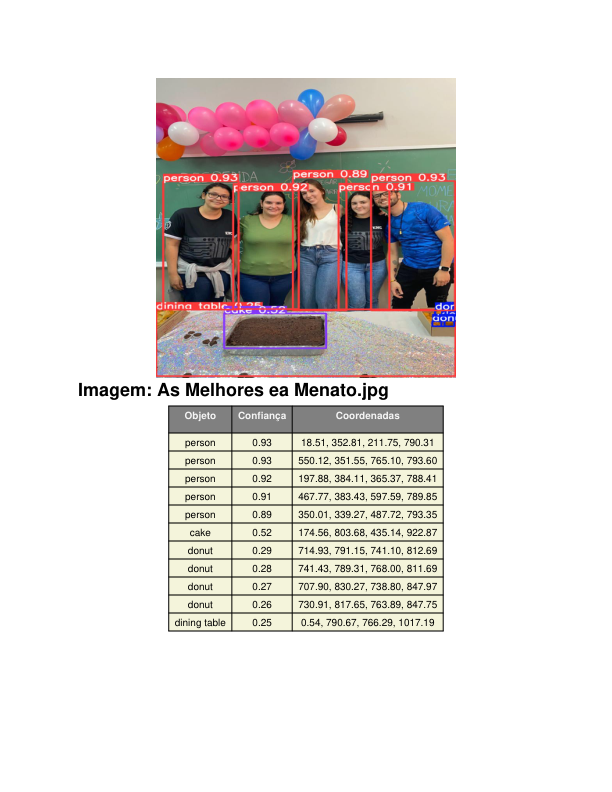

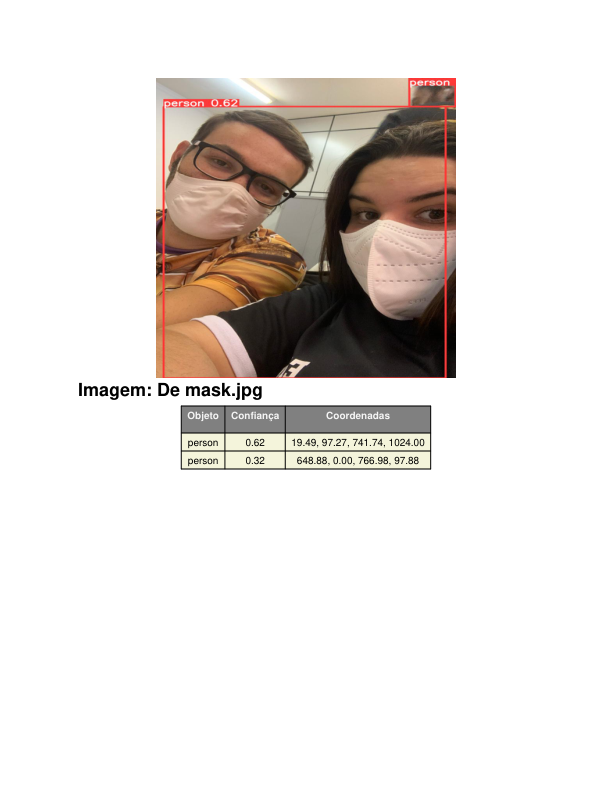

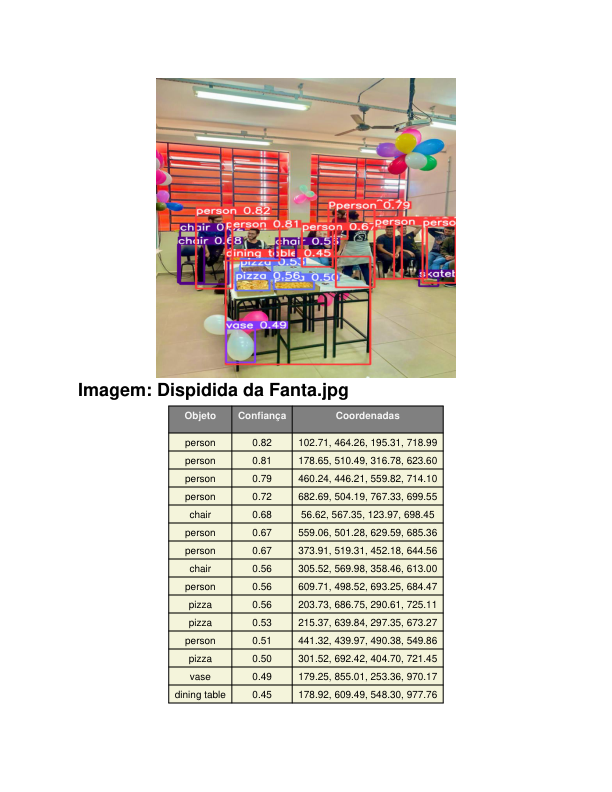

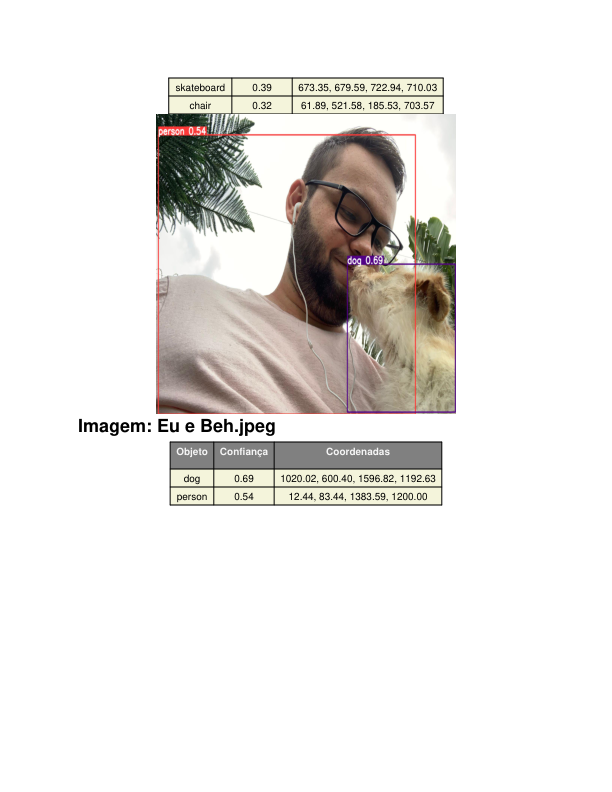

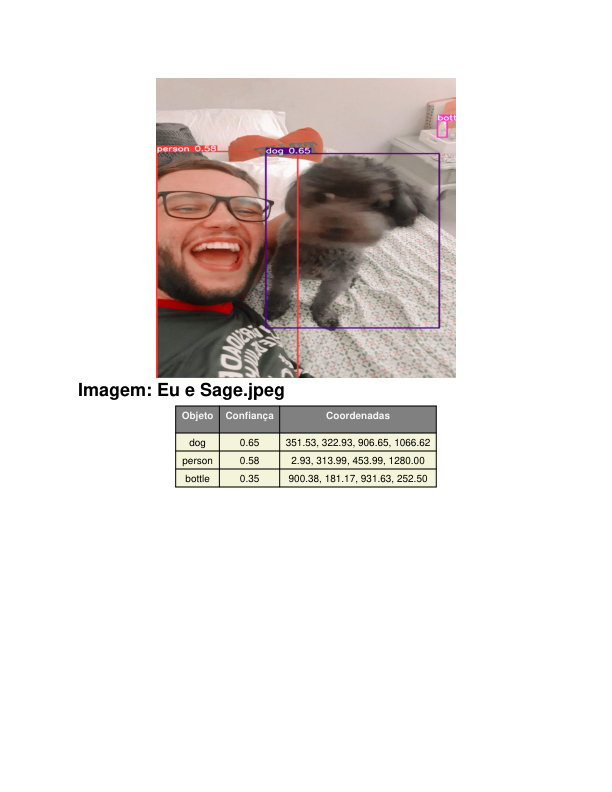

...

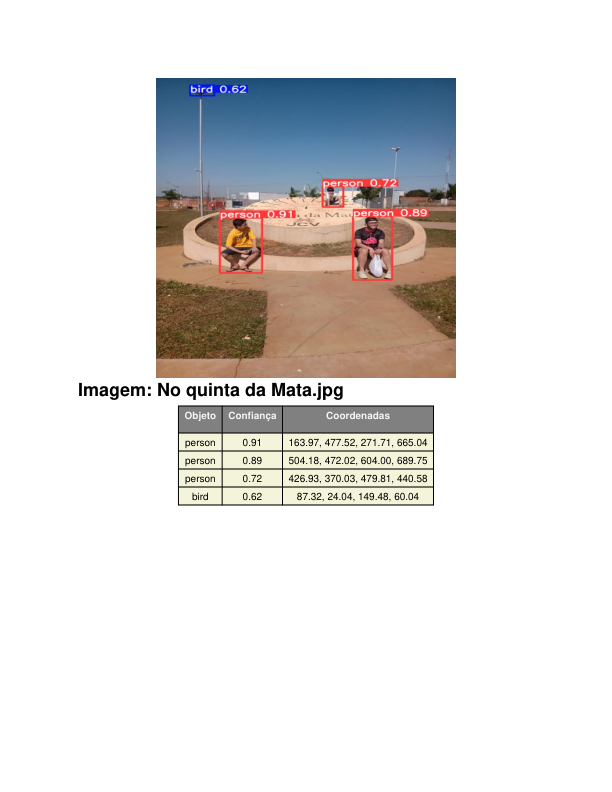

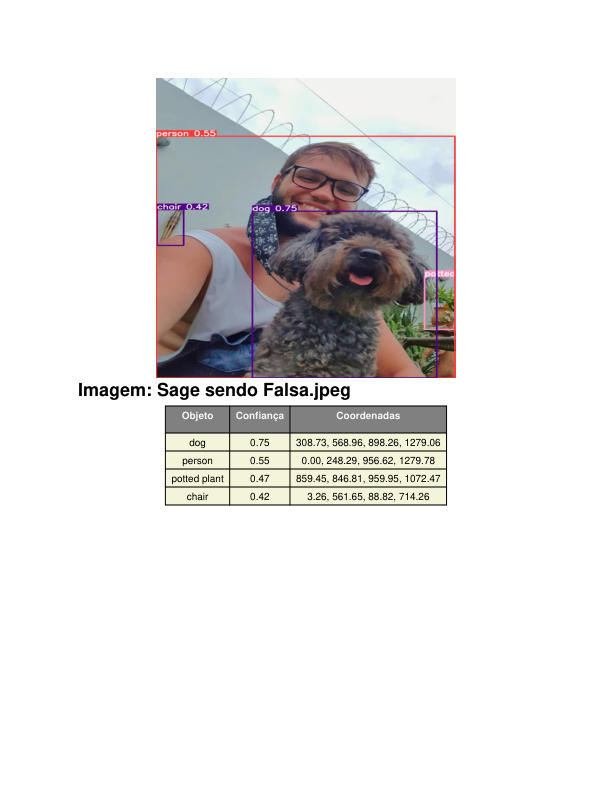

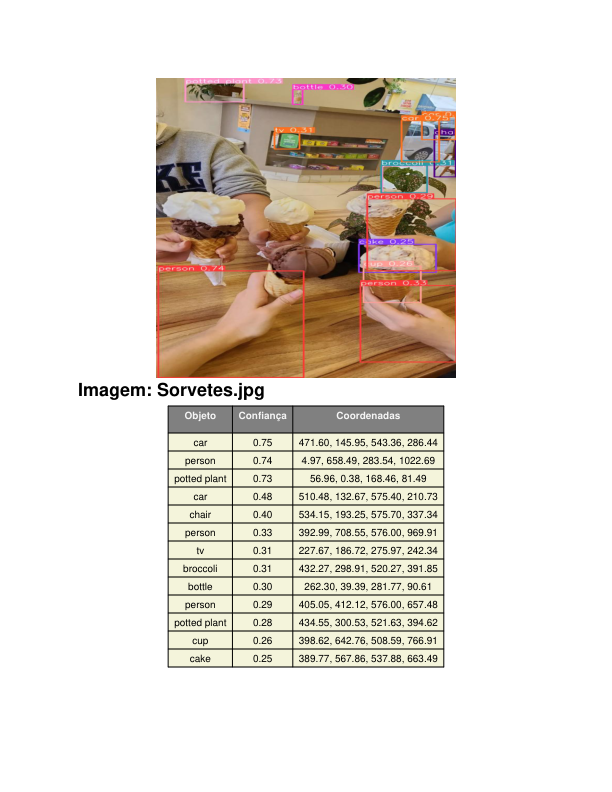

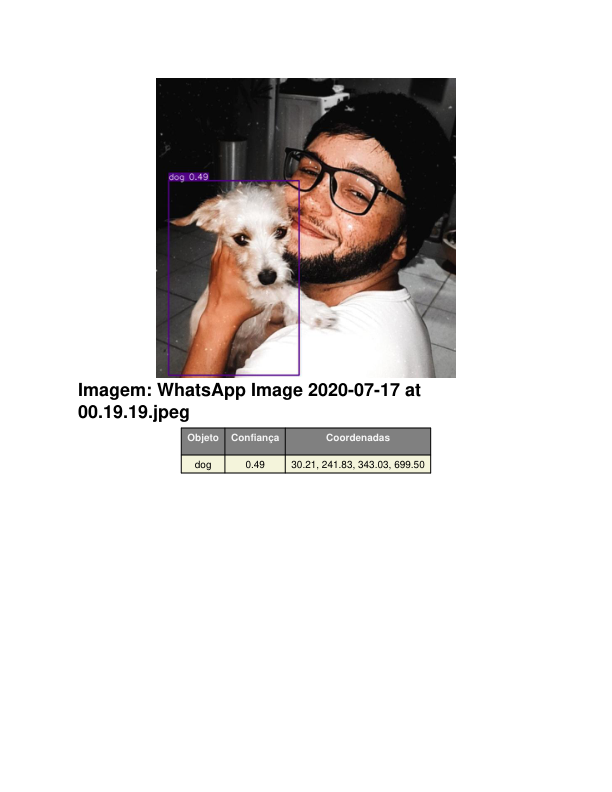

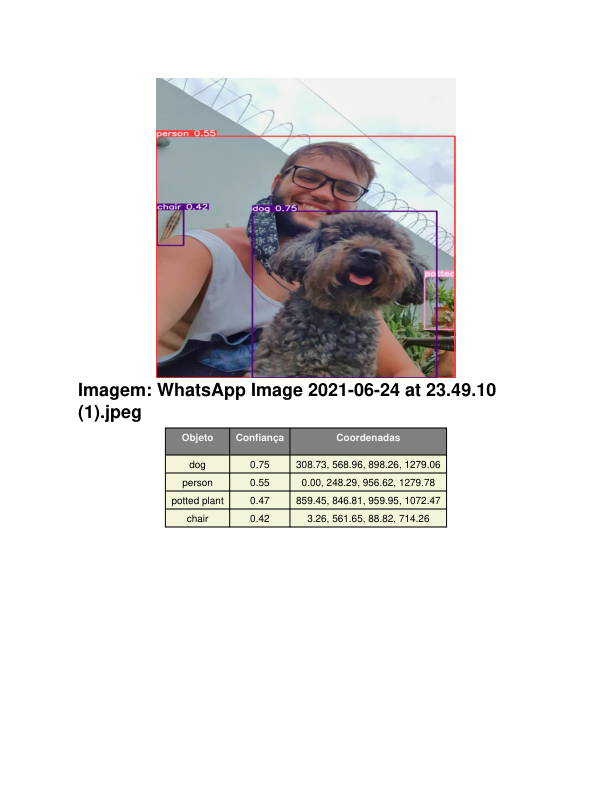

In [66]:
import fitz  # PyMuPDF
from IPython.display import Image, display

def show_pdf(pdf_path):
    pdf_document = fitz.open(pdf_path)

    for page_num in range(len(pdf_document)):
        page = pdf_document.load_page(page_num)
        img_bytes = page.get_pixmap().tobytes("png")
        img = Image(data=img_bytes)
        display(img)

# Caminho para o arquivo PDF
pdf_file_path = '/content/drive/My Drive/Faculdade/Aula/2023.2/Processamento Digital de Imagem/Projeto_Reconhecimento_Objetos/FaceMaskDetection_Yolov5/relatorio.pdf'

# Chame a função para exibir o PDF
show_pdf(pdf_file_path)
